In [130]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

plt.style.use('https://github.com/dhaitz/matplotlib-stylesheets/raw/master/pitayasmoothie-light.mplstyle')

from IPython.display import display

import keras_tuner as kt
import tensorflow as tf
from tensorflow import keras
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

import warnings
warnings.filterwarnings('ignore')

In [131]:
df = pd.read_csv('historic_demand_2009_2024.csv')
df.head()

,settlement_date,settlement_period,period_hour,nd,tsd,england_wales_demand,embedded_wind_generation,embedded_wind_capacity,embedded_solar_generation,embedded_solar_capacity,non_bm_stor,pump_storage_pumping,ifa_flow,ifa2_flow,britned_flow,moyle_flow,east_west_flow,nemo_flow,is_holiday
0,2009-01-01 00:00:00,1,0:00:00,37910,38704,33939,54,1403,0,0,0,33,2002,0,0,-161,0,0,1
1,2009-01-01 00:30:00,2,0:30:00,38047,38964,34072,53,1403,0,0,0,157,2002,0,0,-160,0,0,1
2,2009-01-01 01:00:00,3,1:00:00,37380,38651,33615,53,1403,0,0,0,511,2002,0,0,-160,0,0,1
3,2009-01-01 01:30:00,4,1:30:00,36426,37775,32526,50,1403,0,0,0,589,1772,0,0,-160,0,0,1
4,2009-01-01 02:00:00,5,2:00:00,35687,37298,31877,50,1403,0,0,0,851,1753,0,0,-160,0,0,1


In [132]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 278512 entries, 0 to 278511
Data columns (total 19 columns):
 #   Column                     Non-Null Count   Dtype 
---  ------                     --------------   ----- 
 0   settlement_date            278512 non-null  object
 1   settlement_period          278512 non-null  int64 
 2   period_hour                278512 non-null  object
 3   nd                         278512 non-null  int64 
 4   tsd                        278512 non-null  int64 
 5   england_wales_demand       278512 non-null  int64 
 6   embedded_wind_generation   278512 non-null  int64 
 7   embedded_wind_capacity     278512 non-null  int64 
 8   embedded_solar_generation  278512 non-null  int64 
 9   embedded_solar_capacity    278512 non-null  int64 
 10  non_bm_stor                278512 non-null  int64 
 11  pump_storage_pumping       278512 non-null  int64 
 12  ifa_flow                   278512 non-null  int64 
 13  ifa2_flow                  278512 non-null  

In [133]:
df.isnull().sum()

settlement_date              0
settlement_period            0
period_hour                  0
nd                           0
tsd                          0
england_wales_demand         0
embedded_wind_generation     0
embedded_wind_capacity       0
embedded_solar_generation    0
embedded_solar_capacity      0
non_bm_stor                  0
pump_storage_pumping         0
ifa_flow                     0
ifa2_flow                    0
britned_flow                 0
moyle_flow                   0
east_west_flow               0
nemo_flow                    0
is_holiday                   0
dtype: int64

In [134]:
print(df.duplicated().sum())

0


#### transform datetime objests

In [135]:
df.settlement_date = pd.to_datetime(df.settlement_date)
df.period_hour = pd.to_datetime(df.period_hour, format='%H:%M:%S')

# EDA

In [136]:
N = 48
colors = ['hsl('+str(h)+',50%'+',50%)' for h in np.linspace(0, 360, N)]

fig = go.Figure(data=[go.Box(
    y=df.tsd[df.settlement_period == i],
    marker_color=colors[i-1],
    name=f'{i/2:.0f}' if i%2==0 else f'{i//2}:30',
    showlegend=False
    ) for i in range(1, N+1)])

fig.update_layout(
    title=dict(
        text='Electricity consumption with hours',
        x=0.5
    ),
    xaxis=dict(
        title='hour',
        tickmode='array',
    ),
    yaxis = {'title': 'Electricity demand (MW)'},
    margin=dict(r=10,b=50,l=60)
)

In [137]:
N = 12
colors = ['hsl('+str(h)+',50%'+',50%)' for h in np.linspace(0, 360, N)]

fig = go.Figure(data=[go.Box(
    y=df.tsd[df.settlement_date.dt.month == i],
    marker_color=colors[i-1],
    name=i,
    showlegend=False
    ) for i in range(1, N+1)])

fig.update_layout(
    title=dict(
        text='Electricity consumption with months',
        x=0.5
    ),
    xaxis=dict(
        title='month',
    ),
    yaxis = {'title': 'Electricity demand (MW)'},
    margin=dict(r=10,b=50,l=60)
)

In [138]:
df['day_of_week'] = df['settlement_date'].dt.day_name()

fig = px.box(
    df, 
    x='day_of_week', 
    y='tsd', 
    color='is_holiday', 
    category_orders={
        "day_of_week": ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"],
        "is_holiday": [0, 1]
    },
    title='Daily Distribution of Electricity Consumption and Holiday Effect',
    labels={
        "day_of_week": "Day of the Week",
        "tsd": "Electricity Demand (MW)",
        "is_holiday": "Holiday"
    },
    template='plotly_white'
)

fig.show()

In [139]:
start_year = 2009
end_year = 2023
years = np.arange(start_year, end_year+1)

colors = ['hsl('+str(h)+',50%'+',50%)' for h in np.linspace(0, 360, years.shape[0])]

fig = go.Figure(data=[go.Box(
    y=df.tsd[df.settlement_date.dt.year == year],
    marker_color=colors[i-1],
    name=str(year),
    showlegend=False
    ) for i, year in enumerate(years)])

fig.update_layout(
    title=dict(
        text='Electricity consumption with months',
        x=0.5
    ),
    xaxis=dict(
        title='month',
    ),
    yaxis = {'title': 'Electricity demand (MW)'},
    margin=dict(r=10,b=50,l=60)
)

In [140]:
data = [
    go.Scatter(
        x=np.arange(df.loc[(df.settlement_date > "01-01-2009") & (df.settlement_date < "12-01-2009")].shape[0]),
        y=df.loc[(df.settlement_date > "01-01-2009") & (df.settlement_date < "12-01-2009")]["tsd"],
        mode='lines', name='2009'
    ),
    go.Scatter(
        x=np.arange(df.loc[(df.settlement_date > "01-01-2023") & (df.settlement_date < "12-01-2023")].shape[0]),
        y=df.loc[(df.settlement_date > "01-01-2023") & (df.settlement_date < "12-01-2023")]["tsd"],
        mode='lines', name='2023'
    ),
]

layout = go.Layout(
    title=dict(
        text='Electricity consumption with months',
        x=0.5
    ),
    xaxis=dict(
        title='sample length',
    ),
    yaxis = {'title': 'Electricity demand (MW)'},
    margin=dict(r=10,b=50,l=60),
    showlegend=False
)

fig = go.Figure(data, layout)
fig.show()

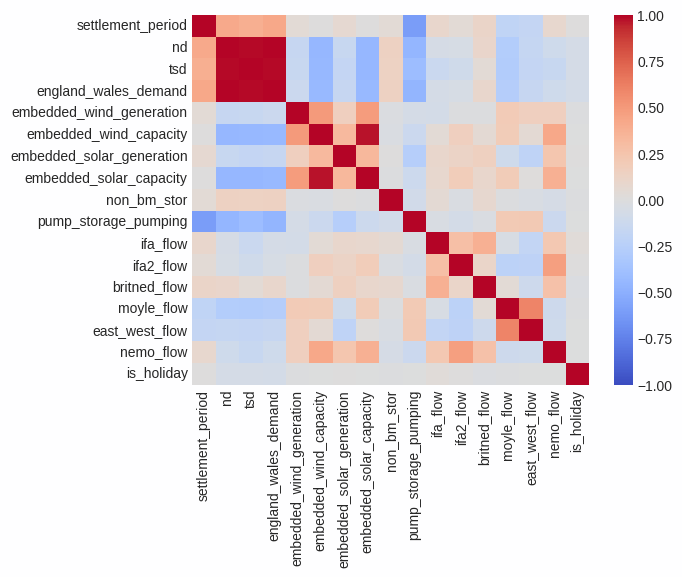

In [141]:
sns.heatmap(df.select_dtypes(include=np.number).corr(), cmap='coolwarm', vmax=1, vmin=-1)
plt.show()

In [142]:
# Choose features that I'll use
df_sample = df[[
    'tsd', 
    'settlement_date', 'settlement_period',
    'embedded_wind_generation', 'embedded_solar_generation', 
    'non_bm_stor', 'pump_storage_pumping', 
    'ifa_flow', 'moyle_flow'
]]


dependable_var = 'tsd'

indexes = ['settlement_period', 'settlement_date']

exogs = [
    'embedded_wind_generation', 
    'embedded_solar_generation', 
    'non_bm_stor', 'pump_storage_pumping', 
    'ifa_flow', 'moyle_flow'
]

# Overall variations
print('Overall variations:')
overall_variations = df_sample[exogs] - df_sample[exogs].mean()
display(overall_variations.describe().T.round(2))

# Between variations
print('Between variations')
between_means = df_sample.groupby(dependable_var).mean()[exogs]
display(between_means.describe().T.round(2))

# Within variations
print('Within variations')
within_variations =  df_sample[exogs] - df_sample.groupby(dependable_var)[exogs].transform('mean')
display(within_variations.describe().T.round(2))

Overall variations:


,count,mean,std,min,25%,50%,75%,max
embedded_wind_generation,278512.0,-0.0,966.55,-1272.09,-720.09,-254.09,456.91,4657.91
embedded_solar_generation,278512.0,-0.0,1710.95,-880.25,-880.25,-880.25,8.75,10343.75
non_bm_stor,278512.0,-0.0,39.20,-30.67,-6.67,-6.67,-6.67,886.33
pump_storage_pumping,278512.0,-0.0,528.16,-304.50,-296.50,-293.50,61.50,1714.50
ifa_flow,278512.0,-0.0,1068.85,-2982.25,-655.25,256.75,965.75,1139.75
moyle_flow,278512.0,-0.0,230.38,-379.85,-177.85,-22.85,150.15,624.15


Between variations


,count,mean,std,min,25%,50%,75%,max
embedded_wind_generation,34601.0,1192.96,441.19,0.00,919.00,1192.50,1457.87,5078.0
embedded_solar_generation,34601.0,707.23,873.57,0.00,51.62,518.20,1070.82,11147.0
non_bm_stor,34601.0,8.77,24.31,-2.62,0.00,0.00,4.60,450.0
pump_storage_pumping,34601.0,235.32,281.43,0.00,10.00,105.92,419.33,1781.0
ifa_flow,34601.0,745.57,716.40,-2055.00,501.00,910.88,1190.50,2014.0
moyle_flow,34601.0,-156.04,131.16,-463.00,-241.80,-150.07,-69.67,402.0


Within variations


,count,mean,std,min,25%,50%,75%,max
embedded_wind_generation,278512.0,0.0,903.12,-2679.17,-636.93,-170.40,436.24,4586.11
embedded_solar_generation,278512.0,0.0,1580.49,-6390.33,-913.00,-352.82,151.36,9727.55
non_bm_stor,278512.0,0.0,35.73,-265.00,-2.40,0.00,0.00,793.78
pump_storage_pumping,278512.0,0.0,449.22,-1266.21,-255.01,-14.92,5.00,1812.29
ifa_flow,278512.0,-0.0,964.93,-3530.25,-542.45,208.71,714.89,3010.83
moyle_flow,278512.0,0.0,207.60,-626.50,-150.15,0.00,143.89,676.38


In [143]:
# 1. Convert settlement_date to datetime
df['settlement_date'] = pd.to_datetime(df['settlement_date'], errors='coerce')

# 2. Extract time-based features
df['day_of_week'] = df['settlement_date'].dt.dayofweek   # Monday=0, Sunday=6
df['month'] = df['settlement_date'].dt.month
df['hour'] = df['settlement_date'].dt.hour
df['minute'] = df['settlement_date'].dt.minute

# 3. Create capacity factors for wind and solar (avoid division by zero)
epsilon = 1e-9
df['wind_factor'] = df['embedded_wind_generation'] / (df['embedded_wind_capacity'] + epsilon)
df['solar_factor'] = df['embedded_solar_generation'] / (df['embedded_solar_capacity'] + epsilon)

# 4. Split flow features into inbound and outbound parts
# For ifa_flow
df['ifa_flow_in'] = df['ifa_flow'].apply(lambda x: x if x > 0 else 0)
df['ifa_flow_out'] = df['ifa_flow'].apply(lambda x: -x if x < 0 else 0)

# For moyle_flow
df['moyle_flow_in'] = df['moyle_flow'].apply(lambda x: x if x > 0 else 0)
df['moyle_flow_out'] = df['moyle_flow'].apply(lambda x: -x if x < 0 else 0)

# For the remaining flow columns: ifa2_flow, britned_flow, east_west_flow, nemo_flow
flow_columns = ['ifa2_flow', 'britned_flow', 'east_west_flow', 'nemo_flow']
for col in flow_columns:
    df[f'{col}_in'] = df[col].apply(lambda x: x if x > 0 else 0)
    df[f'{col}_out'] = df[col].apply(lambda x: -x if x < 0 else 0)
    df.drop(columns=[col], inplace=True)

In [144]:
# 5. Drop columns not needed for modeling
# We drop the original settlement_date and period_hour. The target column 'tsd' will be separated later.
df_fe = df.copy()

# 6. Define target and features
target = 'tsd'
X = df_fe.drop(columns=['settlement_date', 'period_hour', target])
y = df_fe[target]

# 7. One-hot encode categorical features (here, day_of_week)
X = pd.get_dummies(X, columns=['day_of_week'], drop_first=True)

In [145]:
# 8. Train/Test Split (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

print("X_train shape:", X_train.shape)
print("X_test shape:", X_test.shape)
print("y_train shape:", y_train.shape)
print("y_test shape:", y_test.shape)

X_train shape: (222809, 35)
X_test shape: (55703, 35)
y_train shape: (222809,)
y_test shape: (55703,)


In [146]:
# import shutil
# import os

# cache_dir = "hyper_tuning/ann_tuning"
# if os.path.exists(cache_dir):
#     shutil.rmtree(cache_dir)
#     print("Cache cleared.")
# else:
#     print("Cache directory does not exist.")

In [148]:
# Define the hypermodel function
def build_model(hp):
    model = keras.Sequential()
    # Choose number of layers (2 to 4 layers)
    for i in range(hp.Int("num_layers", 2, 4)):
        model.add(keras.layers.Dense(
            hp.Int(f"units_{i}", min_value=32, max_value=128, step=32),
            activation=hp.Choice("activation", ["relu", "tanh", "sigmoid"])
        ))
    # Output layer for regression
    model.add(keras.layers.Dense(1))
    # Compile model with tunable optimizer
    model.compile(
        optimizer=hp.Choice("optimizer", ["adam", "rmsprop", "sgd"]),
        loss="mse",
        metrics=["mae"]
    )
    return model

# Initialize the tuner
tuner = kt.RandomSearch(
    build_model,
    objective="val_loss",  # Minimize validation loss
    max_trials=10,
    executions_per_trial=1,
    directory="hyper_tuning",
    project_name="ann_tuning"
)

# Perform hyperparameter search using training data (X_train, y_train)
tuner.search(X_train, y_train, epochs=1000, validation_split=0.2, verbose=1)

# Retrieve the best hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]
print(f"Best Hyperparameters: {best_hps.values}")

# Build the best model and define early stopping
best_model = tuner.hypermodel.build(best_hps)
early_stopping = keras.callbacks.EarlyStopping(
    monitor="val_loss", patience=20, restore_best_weights=True, verbose=1
)

# Train the best model with early stopping over up to 1000 epochs
history = best_model.fit(
    X_train, y_train,
    epochs=1000,
    validation_split=0.2,
    callbacks=[early_stopping],
    verbose=1
)

Trial 10 Complete [00h 10m 16s]
val_loss: 57424648.0

Best val_loss So Far: 22296.236328125
Total elapsed time: 17h 06m 35s
Best Hyperparameters: {'num_layers': 4, 'units_0': 32, 'activation': 'relu', 'units_1': 128, 'optimizer': 'rmsprop', 'units_2': 32, 'units_3': 32}
Epoch 1/1000
5571/5571 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step - loss: 5117927.5000 - mae: 1119.8340 - val_loss: 108370.3828 - val_mae: 247.3384
Epoch 2/1000
5571/5571 ━━━━━━━━━━━━━━━━━━━━ 6s 1ms/step - loss: 539026.1875 - mae: 627.4766 - val_loss: 580389.6875 - val_mae: 714.7998
Epoch 3/1000
5571/5571 ━━━━━━━━━━━━━━━━━━━━ 7s 1ms/step - loss: 432457.6250 - mae: 563.6811 - val_loss: 254909.2656 - val_mae: 451.6936
Epoch 4/1000
5571/5571 ━━━━━━━━━━━━━━━━━━━━ 6s 1ms/step - loss: 362293.5000 - mae: 512.7482 - val_loss: 167448.3281 - val_mae: 348.7645
Epoch 5/1000
5571/5571 ━━━━━━━━━━━━━━━━━━━━ 7s 1ms/step - loss: 337314.1875 - mae: 489.0966 - val_loss: 298559.7500 - val_mae: 506.3956
Epoch 6/1000
5571/5571 ━━━━━━━━━━━━━━━━━━━━ 7s 

In [149]:
best_model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_4 (Dense)                 │ (None, 32)             │         1,152 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 128)            │         4,224 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 32)             │         4,128 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 21,188 (82.77 KB)

 Trainable params: 10,593 (41.38 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 10,595 (41.39 KB)

In [150]:
history.history.keys()

dict_keys(['loss', 'mae', 'val_loss', 'val_mae'])

In [151]:
# Get the number of epochs
epochs = np.arange(len(history.history['loss']))

# Set step size for x-axis ticks (to avoid overcrowding)
x_ticks = np.linspace(0, len(epochs) - 1, num=10, dtype=int)  # Show only 10 labels

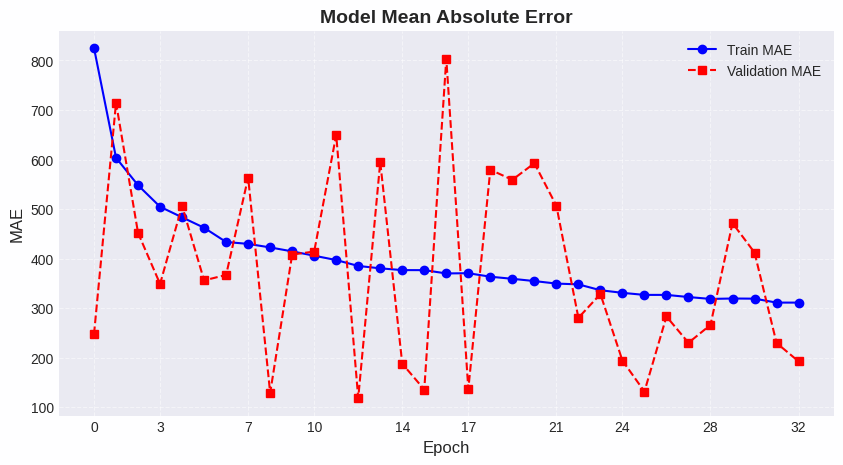

In [152]:
# Plot MAE (Mean Absolute Error)
plt.figure(figsize=(10, 5))
plt.plot(epochs, history.history['mae'], marker='o', linestyle='-', label='Train MAE', color='blue')
plt.plot(epochs, history.history['val_mae'], marker='s', linestyle='--', label='Validation MAE', color='red')

plt.title('Model Mean Absolute Error', fontsize=14, fontweight='bold')
plt.xlabel('Epoch', fontsize=12)
plt.ylabel('MAE', fontsize=12)
plt.legend(loc='best')
plt.grid(True, linestyle='--', alpha=0.5)
plt.xticks(x_ticks)  # Set x-axis ticks dynamically
plt.show()

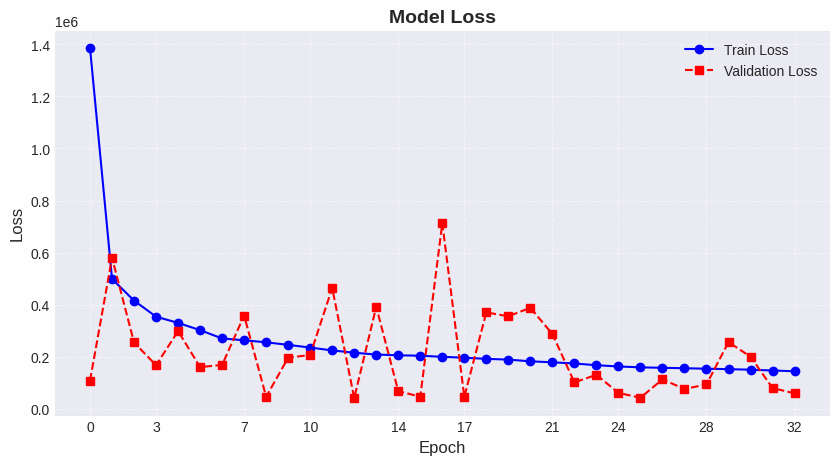

In [153]:
plt.figure(figsize=(10, 5))
plt.plot(epochs, history.history['loss'], marker='o', linestyle='-', label='Train Loss', color='blue')
plt.plot(epochs, history.history['val_loss'], marker='s', linestyle='--', label='Validation Loss', color='red')

plt.title('Model Loss', fontsize=14, fontweight='bold')
plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.legend(loc='best')
plt.grid(True, linestyle='--', alpha=0.5)
plt.xticks(x_ticks)  # Set x-axis ticks dynamically
plt.show()

In [154]:
# Evaluate on test data
test_loss, test_mae = best_model.evaluate(X_test, y_test)
print(f"Test MAE: {test_mae}")

1741/1741 ━━━━━━━━━━━━━━━━━━━━ 2s 950us/step - loss: 42854.6523 - mae: 119.4362
Test MAE: 118.94732666015625


In [155]:
# Make predictions
y_pred = best_model.predict(X_test)

1741/1741 ━━━━━━━━━━━━━━━━━━━━ 1s 599us/step  


In [156]:
# Convert predictions to a DataFrame
df_results = pd.DataFrame({"Actual": y_test, "Predicted": y_pred.flatten()})
df_results.head()

,Actual,Predicted
83646,42758,42787.964844
59769,39032,39074.375000
23208,33859,33847.421875
136167,23711,23718.291016
100318,27058,27123.015625


In [157]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Compute regression evaluation metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

In [158]:
# Print results
print(f"Mean Absolute Error (MAE): {mae:.2f}")
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse:.2f}")
print(f"R² Score: {r2:.4f}")

Mean Absolute Error (MAE): 118.95
Mean Squared Error (MSE): 42906.81
Root Mean Squared Error (RMSE): 207.14
R² Score: 0.9993
